In [44]:
import os
os.environ["TORCHDYNAMO_VERBOSE"] = "1"
os.environ["TORCH_LOGS"] = "+dynamo"
import re
import torch
import time
from sklearn.preprocessing import StandardScaler
import pickle
from torch import nn
import torch.nn.functional as F
from sklearn.manifold import TSNE
import streamlit as st
import matplotlib.pyplot as plt


In [2]:
with open('corpus.txt', 'r', encoding='utf-8') as f:
    content = f.read()


In [3]:
content = re.sub('[^a-zA-Z0-9. \s]', '', content)
content = re.sub(r'\s+', ' ', content).strip()
content = (content.lower())

print(content[:30])

well prince so genoa and lucca


<>:1: SyntaxWarning: invalid escape sequence '\s'
<>:1: SyntaxWarning: invalid escape sequence '\s'
C:\Users\saara\AppData\Local\Temp\ipykernel_21284\3715237293.py:1: SyntaxWarning: invalid escape sequence '\s'
  content = re.sub('[^a-zA-Z0-9. \s]', '', content)


In [4]:
words = content.split(" ")
words_with_stop = []
word_dict = {
    "." : 0
}
for word in words:
    if "." in word:  
        word = word.replace('.', '')
        word_dict['.'] = word_dict['.'] + 1
        words_with_stop.append(word)
        words_with_stop.append('.')
    else:
        words_with_stop.append(word)
    if(word_dict.get(word)):
        word_dict[word] = word_dict[word]+1
    else:
        word_dict[word] = 1

In [5]:
print(words_with_stop[:20])

['well', 'prince', 'so', 'genoa', 'and', 'lucca', 'are', 'now', 'just', 'family', 'estates', 'of', 'the', 'buonapartes', '.', 'but', 'i', 'warn', 'you', 'if']


In [6]:
print(f"Length of the vocabulary is: {len(word_dict)}")


Length of the vocabulary is: 20082


In [7]:
sorted_items_asc = sorted(word_dict.items(), key=lambda item: item[1])
print("Least common words are: \n")
for x in range (10):
    print(f"{x+1}. {sorted_items_asc[x][0]} Count: {sorted_items_asc[x][1]}")

Least common words are: 

1. infamies Count: 1
2. yousit Count: 1
3. elite Count: 1
4. scarletliveried Count: 1
5. 10annette Count: 1
6. grandfathers Count: 1
7. canceled Count: 1
8. woundup Count: 1
9. tease Count: 1
10. novosiltsevs Count: 1


In [8]:
sorted_items_dsc = sorted(word_dict.items(), key=lambda item: item[1], reverse=True)
print("Most common words are: \n")
for x in range (10):
    print(f"{x+1}. {sorted_items_dsc[x][0]} Count: {sorted_items_dsc[x][1]}")

Most common words are: 

1. the Count: 34394
2. . Count: 26652
3. and Count: 22082
4. to Count: 16636
5. of Count: 14871
6. a Count: 10464
7. he Count: 9807
8. in Count: 8743
9. his Count: 7967
10. that Count: 7798


In [9]:
# build the vocabulary of characters and mappings to/from integers
i = 0
stoi = {}
stoi['_'] = 0
for word in word_dict.keys():
    stoi[word] = i+1
    i = i+1

print(stoi)

{'_': 0, '.': 1, 'well': 2, 'prince': 3, 'so': 4, 'genoa': 5, 'and': 6, 'lucca': 7, 'are': 8, 'now': 9, 'just': 10, 'family': 11, 'estates': 12, 'of': 13, 'the': 14, 'buonapartes': 15, 'but': 16, 'i': 17, 'warn': 18, 'you': 19, 'if': 20, 'dont': 21, 'tell': 22, 'me': 23, 'that': 24, 'this': 25, 'means': 26, 'war': 27, 'still': 28, 'try': 29, 'to': 30, 'defend': 31, 'infamies': 32, 'horrors': 33, 'perpetrated': 34, 'by': 35, 'antichristi': 36, 'really': 37, 'believe': 38, 'he': 39, 'is': 40, 'will': 41, 'have': 42, 'nothing': 43, 'more': 44, 'do': 45, 'with': 46, 'no': 47, 'longer': 48, 'my': 49, 'friend': 50, 'faithful': 51, 'slave': 52, 'as': 53, 'call': 54, 'yourself': 55, 'how': 56, 'see': 57, 'frightened': 58, 'yousit': 59, 'down': 60, 'all': 61, 'news': 62, 'it': 63, 'was': 64, 'in': 65, 'july': 66, '1805': 67, 'speaker': 68, 'wellknown': 69, 'anna': 70, 'pavlovna': 71, 'scherer': 72, 'maid': 73, 'honor': 74, 'favorite': 75, 'empress': 76, 'marya': 77, 'fedorovna': 78, 'these': 79

In [10]:
itos = {i:s for s,i in stoi.items()}
print(itos)

{0: '_', 1: '.', 2: 'well', 3: 'prince', 4: 'so', 5: 'genoa', 6: 'and', 7: 'lucca', 8: 'are', 9: 'now', 10: 'just', 11: 'family', 12: 'estates', 13: 'of', 14: 'the', 15: 'buonapartes', 16: 'but', 17: 'i', 18: 'warn', 19: 'you', 20: 'if', 21: 'dont', 22: 'tell', 23: 'me', 24: 'that', 25: 'this', 26: 'means', 27: 'war', 28: 'still', 29: 'try', 30: 'to', 31: 'defend', 32: 'infamies', 33: 'horrors', 34: 'perpetrated', 35: 'by', 36: 'antichristi', 37: 'really', 38: 'believe', 39: 'he', 40: 'is', 41: 'will', 42: 'have', 43: 'nothing', 44: 'more', 45: 'do', 46: 'with', 47: 'no', 48: 'longer', 49: 'my', 50: 'friend', 51: 'faithful', 52: 'slave', 53: 'as', 54: 'call', 55: 'yourself', 56: 'how', 57: 'see', 58: 'frightened', 59: 'yousit', 60: 'down', 61: 'all', 62: 'news', 63: 'it', 64: 'was', 65: 'in', 66: 'july', 67: '1805', 68: 'speaker', 69: 'wellknown', 70: 'anna', 71: 'pavlovna', 72: 'scherer', 73: 'maid', 74: 'honor', 75: 'favorite', 76: 'empress', 77: 'marya', 78: 'fedorovna', 79: 'these'

In [11]:
block_size = 5
X, Y = [],[]
i=0
while i < (len(words_with_stop)):
    context =  [0] * block_size
    while words_with_stop[i] != '.':
        idx = stoi[words_with_stop[i]]
        X.append(context)
        Y.append(idx)
        print(' '.join(itos[i] for i in context), '--->', itos[idx])
        context = context[1:] + [idx]
        i=i+1
        
    if i < len(words_with_stop) and words_with_stop[i] == '.':
        X.append(context)
        Y.append(stoi['.'])
        print(' '.join(itos[j] for j in context), '--->', '.')
        i += 1
    


_ _ _ _ _ ---> well
_ _ _ _ well ---> prince
_ _ _ well prince ---> so
_ _ well prince so ---> genoa
_ well prince so genoa ---> and
well prince so genoa and ---> lucca
prince so genoa and lucca ---> are
so genoa and lucca are ---> now
genoa and lucca are now ---> just
and lucca are now just ---> family
lucca are now just family ---> estates
are now just family estates ---> of
now just family estates of ---> the
just family estates of the ---> buonapartes
family estates of the buonapartes ---> .
_ _ _ _ _ ---> but
_ _ _ _ but ---> i
_ _ _ but i ---> warn
_ _ but i warn ---> you
_ but i warn you ---> if
but i warn you if ---> you
i warn you if you ---> dont
warn you if you dont ---> tell
you if you dont tell ---> me
if you dont tell me ---> that
you dont tell me that ---> this
dont tell me that this ---> means
tell me that this means ---> war
me that this means war ---> if
that this means war if ---> you
this means war if you ---> still
means war if you still ---> try
war if you still t

In [12]:
X = torch.tensor(X[:262144]).to("cuda")
Y = torch.tensor(Y[:262144]).to("cuda")
print(X.shape)

torch.Size([262144, 5])


In [13]:
print(X.shape)

torch.Size([262144, 5])


In [14]:
def plot_embeddings(selected_words, embeds, mode ="before"):
    indices = [stoi[w] for w in selected_words]
    indices = torch.tensor(indices)
    if mode == "before":
        selected_embeddings = embeds(indices).detach().cpu().numpy()
    else:
        selected_embeddings = embeds
    tsne = TSNE(n_components=2, random_state=42, perplexity=3)
    reduced = tsne.fit_transform(selected_embeddings)
    plt.figure(figsize=(10, 8))
    for i, word in enumerate(selected_words):
        x, y = reduced[i, 0], reduced[i, 1]
        plt.scatter(x, y)
        plt.text(x + 0.02, y + 0.02, word)
    plt.title("t-SNE Visualization of Learned Word Embeddings before training")
    plt.show()


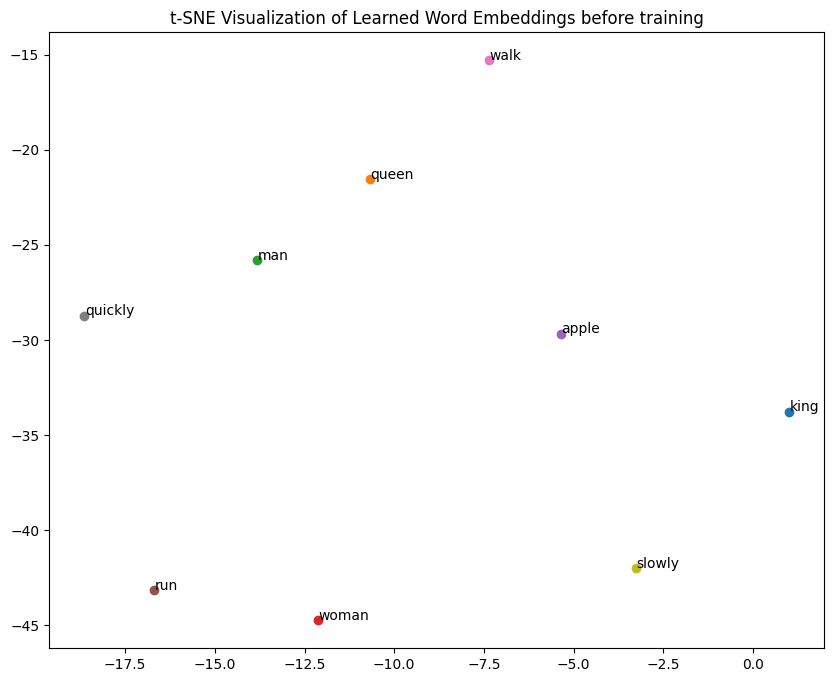

In [15]:
embeds = nn.Embedding(len(stoi), 32)
selected_words = ['king', 'queen', 'man', 'woman', 'apple', 'run', 'walk', 'quickly', 'slowly']
plot_embeddings(selected_words, embeds)

In [ ]:
class NextWord(nn.Module):
    def __init__(self, vocab_size, context_size=5, embed_dim=32):
        super().__init__()
        self.embedding = nn.Embedding(vocab_size, embed_dim)
        input_dim = context_size * embed_dim
        self.hidden_layer1 = nn.Linear(input_dim, 512)
        self.dropout = nn.Dropout(0.4)
        self.hidden_layer2 = nn.Linear(512, 512)
        self.dropout = nn.Dropout(0.4)
        self.output = nn.Linear(512, vocab_size)

    def forward(self, x):
        embeds = self.embedding(x)
        embeds = embeds.view(embeds.shape[0], -1)
        h2 = F.relu(self.hidden_layer1(embeds))
        h2 = self.dropout(h2)
        h2=F.relu(self.hidden_layer2(h2))
        h2 = self.dropout(h2)
        logits = F.relu(self.output(h2))
        return logits

In [17]:
model = NextWord(len(stoi), 5, embed_dim=32).to('cuda')
model = torch.compile(model,  backend="eager")

In [18]:
def count_params(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

def print_model_summary(model):
    print("Model Summary:")
    for name, module in model.named_modules():
        if len(list(module.children())) == 0:
            params = sum(p.numel() for p in module.parameters())
            print(f"{name:<20} {params:,} parameters")
    print(f"\nTotal trainable parameters: {count_params(model):,}\n")

In [19]:
g = torch.Generator()
g.manual_seed(4000002)
model = model.to("cuda")
def generate_name(model, itos, stoi,existing_string, block_size=5, max_len=20, ):
    model.eval()
    context = []
    existing_string = existing_string.lower()
    if(len(existing_string)>0):
        wr = existing_string.split(" ")
        if(len(wr)>block_size):
            wr=wr[-block_size:]
        else:
            while len(wr) < block_size:
                wr.insert(0,'_')
        for ele in wr:
            context.append(stoi[ele])
    else:
        context = [0] * block_size
    with torch.no_grad():
        sentence = ''
        for i in range(max_len):
            x = torch.tensor(context).view(1,-1).to("cuda")
            y_pred = model(x)
            probs = torch.softmax(y_pred, dim=-1)
            ix = torch.argmax(probs, dim=-1).item()
            word = itos[ix]
            if word == '.':
                sentence+='.'
                break
            sentence+=" "+ word
            context = context[1:] + [ix]
            i=i+1
    model.train()
    return sentence


In [20]:
print_model_summary(model)

Model Summary:
_orig_mod.embedding  642,656 parameters
_orig_mod.hidden_layer1 82,432 parameters
_orig_mod.dropout    0 parameters
_orig_mod.hidden_layer2 262,656 parameters
_orig_mod.output     10,302,579 parameters

Total trainable parameters: 11,290,323



In [21]:
sentence = generate_name(model, itos, stoi,"", block_size)
print(f"Randomly generated sentence before training: \n{sentence}")

V1028 14:16:45.190000 21284 site-packages\torch\_dynamo\convert_frame.py:1458] skipping: _wrapped_call_impl (reason: in skipfiles, file: c:\Users\saara\AppData\Local\Programs\Python\Python313\Lib\site-packages\torch\nn\modules\module.py)
V1028 14:16:45.192000 21284 site-packages\torch\_dynamo\convert_frame.py:1458] skipping: _call_impl (reason: in skipfiles, file: c:\Users\saara\AppData\Local\Programs\Python\Python313\Lib\site-packages\torch\nn\modules\module.py)
I1028 14:16:45.199000 21284 site-packages\torch\_dynamo\utils.py:1697] [0/0] ChromiumEventLogger initialized with id 5c19a511-605f-4a61-b51e-0c0024a81dba
V1028 14:16:45.218000 21284 site-packages\torch\_dynamo\convert_frame.py:1055] [0/0] torchdynamo start compiling forward C:\Users\saara\AppData\Local\Temp\ipykernel_21284\3486279970.py:12, stack (elided 5 frames):
V1028 14:16:45.218000 21284 site-packages\torch\_dynamo\convert_frame.py:1055] [0/0]   File "<frozen runpy>", line 198, in _run_module_as_main
V1028 14:16:45.218000

Randomly generated sentence before training: 
 fatherand fatherand voyez executor executor zhilinskis sturdily injuries donned injuries genlis generalization fatherand sonyashould injuries behave injuries injuries generalization assisted


In [22]:
split = int(0.8 * len(X))
X_train, X_val = X[:split], X[split:]
Y_train, Y_val = Y[:split], Y[split:]

In [23]:
def train_model(model, X_train,Y_train,X_val, Y_val, lr, epochs =500, batch_size = 512,  wd = 1e-2, print_every = 100):
    model.train()
    opt = torch.optim.AdamW(model.parameters(), lr=lr, weight_decay=wd)
    loss_fn = nn.CrossEntropyLoss()
    train_losses, times, validation_losses = [], [], []
    for e in range(epochs):
        start = time.time()
        total_loss = 0
        n_batches = 0
        for i in range(0, X_train.shape[0], batch_size):
            x_batch = X_train[i:i+batch_size]
            y_batch = Y_train[i:i+batch_size]
            logits = model(x_batch)
            loss = loss_fn(logits, y_batch)
            opt.zero_grad()
            loss.backward()
            opt.step()

            total_loss += loss.item()
            n_batches += 1
        avg_loss = total_loss / n_batches
        train_losses.append(avg_loss)
        times.append(time.time() - start)
        model.eval()
        with torch.no_grad():
            logits_val = model(X_val)
            val_loss = loss_fn(logits_val, Y_val).item()
        
        validation_losses.append(val_loss)
        times.append(time.time() - start)
        print(f"Epoch {e:4d} | Loss: {avg_loss:.4f} | Validation_loss: {val_loss:.4f} Time: {times[-1]:.2f}s")
    return train_losses,validation_losses, times



In [24]:
train_losses,validation_losses, times = train_model(model, X_train,Y_train, X_val, Y_val,lr=1e-5, epochs=700, batch_size=2048,  wd=0.01, print_every=50)
torch.save(model, "natural_language.pth")

V1028 14:16:46.202000 21284 site-packages\torch\_dynamo\convert_frame.py:1055] [0/1] torchdynamo start compiling forward C:\Users\saara\AppData\Local\Temp\ipykernel_21284\3486279970.py:12, stack (elided 5 frames):
V1028 14:16:46.202000 21284 site-packages\torch\_dynamo\convert_frame.py:1055] [0/1]   File "<frozen runpy>", line 198, in _run_module_as_main
V1028 14:16:46.202000 21284 site-packages\torch\_dynamo\convert_frame.py:1055] [0/1]   File "<frozen runpy>", line 88, in _run_code
V1028 14:16:46.202000 21284 site-packages\torch\_dynamo\convert_frame.py:1055] [0/1]   File "C:\Users\saara\AppData\Roaming\Python\Python313\site-packages\ipykernel_launcher.py", line 18, in <module>
V1028 14:16:46.202000 21284 site-packages\torch\_dynamo\convert_frame.py:1055] [0/1]     app.launch_new_instance()
V1028 14:16:46.202000 21284 site-packages\torch\_dynamo\convert_frame.py:1055] [0/1]   File "C:\Users\saara\AppData\Roaming\Python\Python313\site-packages\traitlets\config\application.py", line 10

Epoch    0 | Loss: 9.8804 | Validation_loss: 9.8433 Time: 6.48s


V1028 14:16:52.874000 21284 site-packages\torch\_dynamo\symbolic_convert.py:1260] [0/3] [__trace_bytecode] TRACE PUSH_NULL None [LazyVariableTracker()]
V1028 14:16:52.879000 21284 site-packages\torch\_dynamo\symbolic_convert.py:1260] [0/3] [__trace_bytecode] TRACE LOAD_FAST input [LazyVariableTracker(), NullVariable]
V1028 14:16:52.881000 21284 site-packages\torch\_dynamo\symbolic_convert.py:1260] [0/3] [__trace_bytecode] TRACE LOAD_FAST self [LazyVariableTracker(), NullVariable, TensorVariable()]
V1028 14:16:52.883000 21284 site-packages\torch\_dynamo\symbolic_convert.py:1260] [0/3] [__trace_bytecode] TRACE LOAD_ATTR weight [LazyVariableTracker(), NullVariable, TensorVariable(), UnspecializedBuiltinNNModuleVariable(Linear)]
V1028 14:16:52.887000 21284 site-packages\torch\_dynamo\variables\builder.py:3373] [0/3] wrap_to_fake L['self']._modules['hidden_layer1']._parameters['weight'] (512, 160) StatefulSymbolicContext(dynamic_sizes=[<DimDynamic.STATIC: 2>, <DimDynamic.STATIC: 2>], dynami

Epoch    1 | Loss: 9.7816 | Validation_loss: 9.7056 Time: 11.66s
Epoch    2 | Loss: 9.5613 | Validation_loss: 9.4006 Time: 4.18s
Epoch    3 | Loss: 9.1460 | Validation_loss: 8.8774 Time: 4.79s
Epoch    4 | Loss: 8.5234 | Validation_loss: 8.2305 Time: 4.13s
Epoch    5 | Loss: 7.9228 | Validation_loss: 7.7043 Time: 4.75s
Epoch    6 | Loss: 7.4624 | Validation_loss: 7.3242 Time: 4.29s
Epoch    7 | Loss: 7.1642 | Validation_loss: 7.1116 Time: 4.77s
Epoch    8 | Loss: 7.0099 | Validation_loss: 7.0098 Time: 4.10s
Epoch    9 | Loss: 6.9332 | Validation_loss: 6.9565 Time: 5.09s
Epoch   10 | Loss: 6.8884 | Validation_loss: 6.9231 Time: 4.12s
Epoch   11 | Loss: 6.8577 | Validation_loss: 6.8997 Time: 5.11s
Epoch   12 | Loss: 6.8348 | Validation_loss: 6.8824 Time: 4.14s
Epoch   13 | Loss: 6.8167 | Validation_loss: 6.8692 Time: 4.78s
Epoch   14 | Loss: 6.8020 | Validation_loss: 6.8583 Time: 4.13s
Epoch   15 | Loss: 6.7896 | Validation_loss: 6.8493 Time: 4.78s
Epoch   16 | Loss: 6.7790 | Validation_

In [27]:
existing_string = "What are"
sentence = generate_name(model, itos, stoi,existing_string, block_size, )
print(f"Generated sentence: {sentence}")
print(f"Complete sentence: {existing_string+sentence}")

Generated sentence:  you going to me.
Complete sentence: What are you going to me.


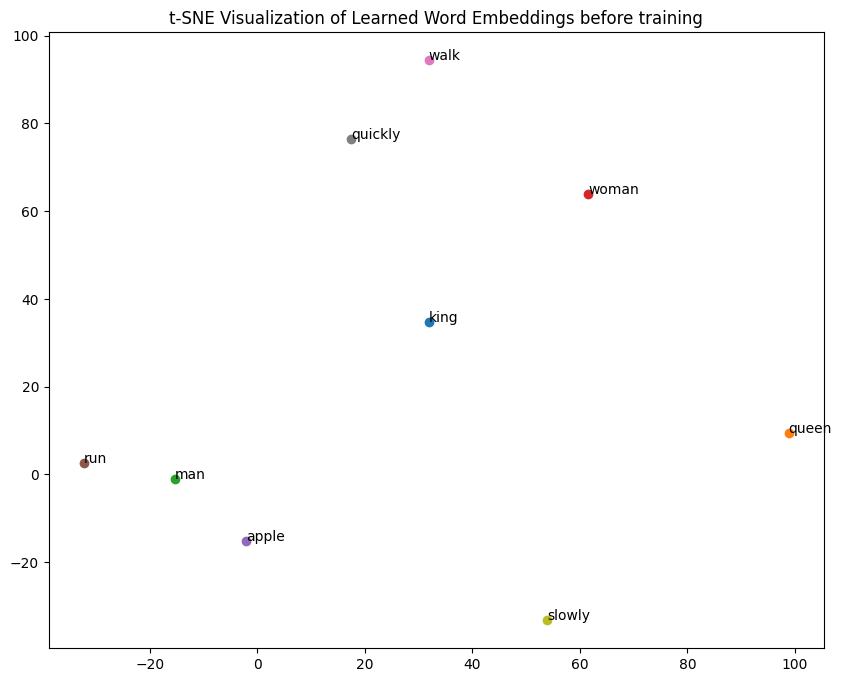

In [26]:
embedding_matrix = model.embedding.weight.detach().cpu().numpy()
selected_words = ['king', 'queen', 'man', 'woman', 'apple', 'run', 'walk', 'quickly', 'slowly']
plot_embeddings(selected_words, embedding_matrix, mode="after")

In [ ]:
epochs = []
print(len(train_losses))
print(len(validation_losses))
for i in range(1, 701):
    epochs.append(i)
    


700
700
1


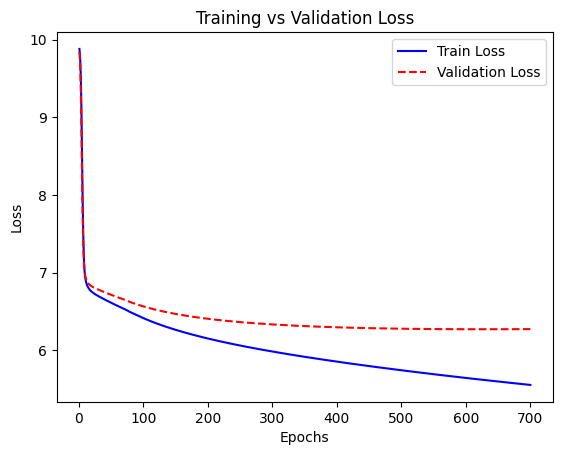

In [37]:
plt.plot(epochs, train_losses, label='Train Loss', color='blue', linestyle='-')
plt.plot(epochs, validation_losses, label='Validation Loss', color='red', linestyle='--')
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Training vs Validation Loss")
plt.legend()
plt.show()

In [42]:
import pickle

with open("next_word.pkl", "wb") as model_file:
    pickle.dump(model, model_file)

In [43]:
model = torch.load('natural_language.pth', weights_only=False)

In [47]:
with open('exported_variables.pkl', 'wb') as f:
    pickle.dump(stoi, f)
    pickle.dump(itos, f)